## Import Modules

In [23]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

## Load the files

In [24]:
BASE_DIR = '/kaggle/input/anime-faces/data/'

In [25]:
# load complete image paths to the list
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [26]:
image_paths[:5]

['/kaggle/input/anime-faces/data/21130.png',
 '/kaggle/input/anime-faces/data/9273.png',
 '/kaggle/input/anime-faces/data/18966.png',
 '/kaggle/input/anime-faces/data/14127.png',
 '/kaggle/input/anime-faces/data/18054.png']

In [27]:
# remove unnecessary file
image_paths.remove('/kaggle/input/anime-faces/data/data')

In [28]:
len(image_paths)

21551

## Visualize the Image Dataset

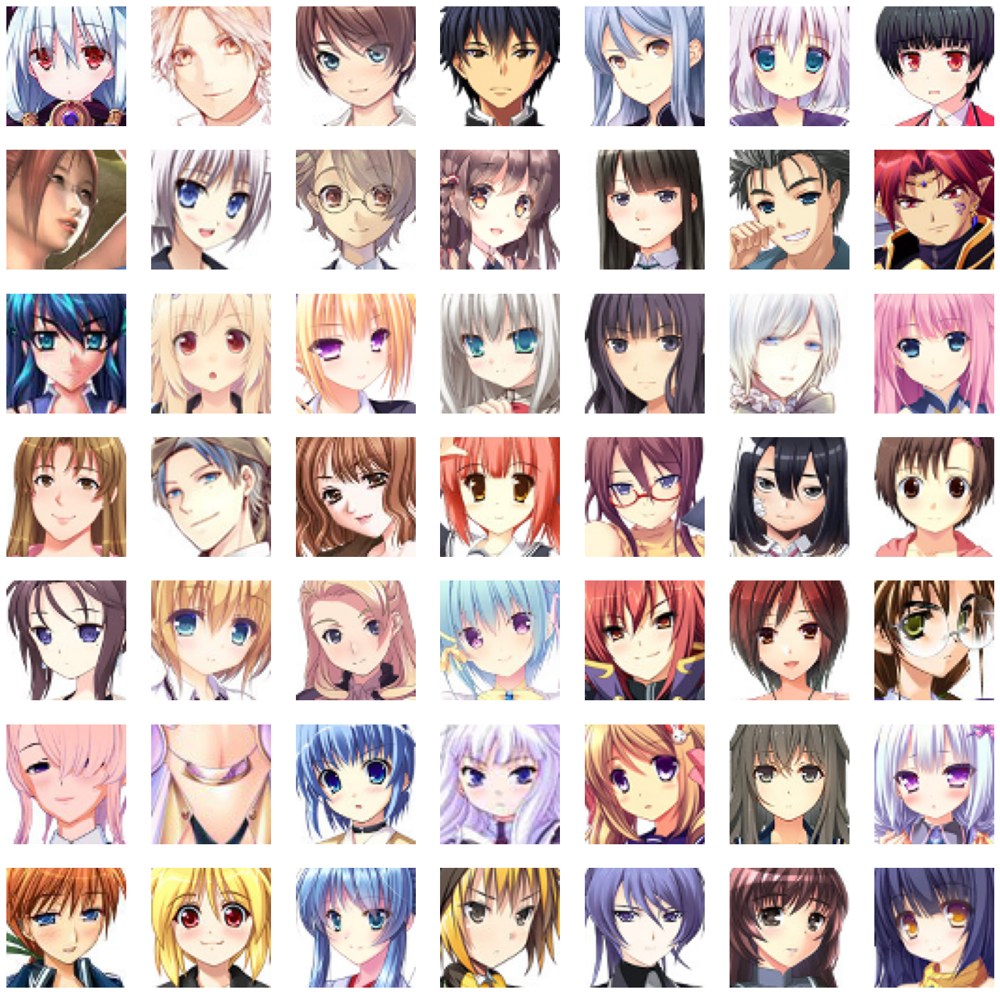

In [29]:
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

## Preprocessing the Images

In [30]:
# load the image and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [31]:
train_images[0].shape

(64, 64, 3)

In [32]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [33]:
# normalize the images
train_images = (train_images - 127.5) / 127.5

In [34]:
train_images[0]

array([[[-0.7254902 , -0.90588236, -0.7176471 ],
        [-0.70980394, -0.88235295, -0.6862745 ],
        [-0.7019608 , -1.        , -0.7176471 ],
        ...,
        [-0.09019608,  0.01176471,  0.3882353 ],
        [-0.19215687,  0.05882353,  0.4509804 ],
        [-0.34117648, -0.13725491,  0.29411766]],

       [[-0.7254902 , -0.90588236, -0.7176471 ],
        [-0.73333335, -0.8666667 , -0.7019608 ],
        [-0.52156866, -0.8666667 , -0.5686275 ],
        ...,
        [-0.29411766,  0.01176471,  0.3019608 ],
        [-0.08235294,  0.15294118,  0.5294118 ],
        [-0.23921569,  0.09019608,  0.45882353]],

       [[-0.7019608 , -0.8901961 , -0.7019608 ],
        [-0.7176471 , -0.8745098 , -0.69411767],
        [-0.5686275 , -0.8509804 , -0.58431375],
        ...,
        [-0.22352941,  0.1764706 ,  0.48235294],
        [-0.13725491,  0.1764706 ,  0.4745098 ],
        [-0.06666667,  0.24705882,  0.5058824 ]],

       ...,

       [[-0.30980393, -0.6862745 , -0.29411766],
        [-0

## Create Generator & Discriminator Models

In [36]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

### Generator Model

Generator Model will create new images similar to training data from random noise

In [37]:
model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_2 (Dense)                      │ (None, 32768)               │       3,309,568 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_4 (ReLU)                       │ (None, 32768)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_1 (Reshape)                  │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_3 (Conv2DTranspose) │ (None, 16, 16, 256)         │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_5 (ReLU)                       │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_4 (Conv2DTranspose) │ (None, 32, 32, 128)         │         524,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_6 (ReLU)                       │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_5 (Conv2DTranspose) │ (None, 64, 64, 64)          │         131,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_7 (ReLU)                       │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 64, 64, 3)           │           3,075 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,065,603 (23.14 MB)

 Trainable params: 6,065,603 (23.14 MB)

 Non-trainable params: 0 (0.00 B)

### Discriminator Model

Discriminator model will classify the image from the generator to check whether it real (or) fake images.

In [38]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_5 (Conv2D)                    │ (None, 32, 32, 64)          │           3,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_7                │ (None, 32, 32, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_3 (LeakyReLU)            │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_6 (Conv2D)                    │ (None, 16, 16, 128)         │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_8                │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_4 (LeakyReLU)            │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 8, 8, 128)           │         262,272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_9                │ (None, 8, 8, 128)           │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_5 (LeakyReLU)            │ (None, 8, 8, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 1)                   │           8,193 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

## Create DCGAN

In [39]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')
        
    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]
    
    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn
        
    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))
        
        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)
            
            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)
            
            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2
            
        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))
        
        
        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)
            
        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))
        
        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        
        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [40]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()
        
        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()
        
    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [41]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

making the lr of discriminator slow so that he learns slowly so that generator also gets chance to learn warna it will supress the generator

In [42]:
D_LR = 0.0001 
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - d_loss: 1.4928 - g_loss: 1.6277

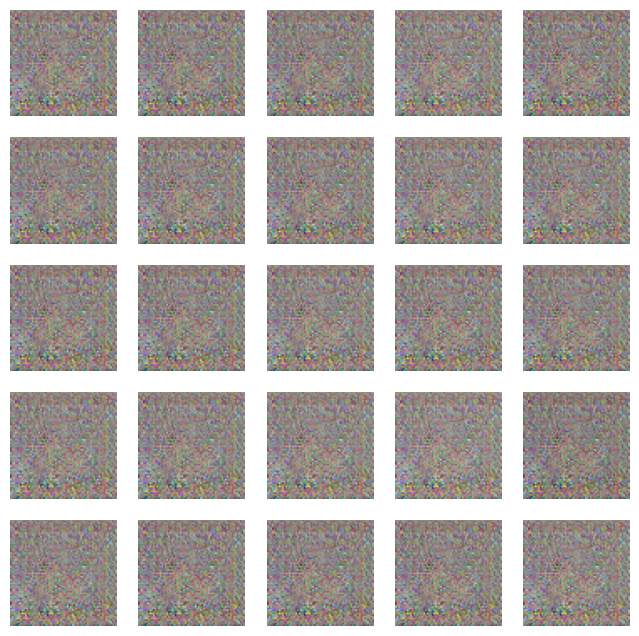

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 48ms/step - d_loss: 1.4917 - g_loss: 1.6291
Epoch 2/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.4288 - g_loss: 2.5407

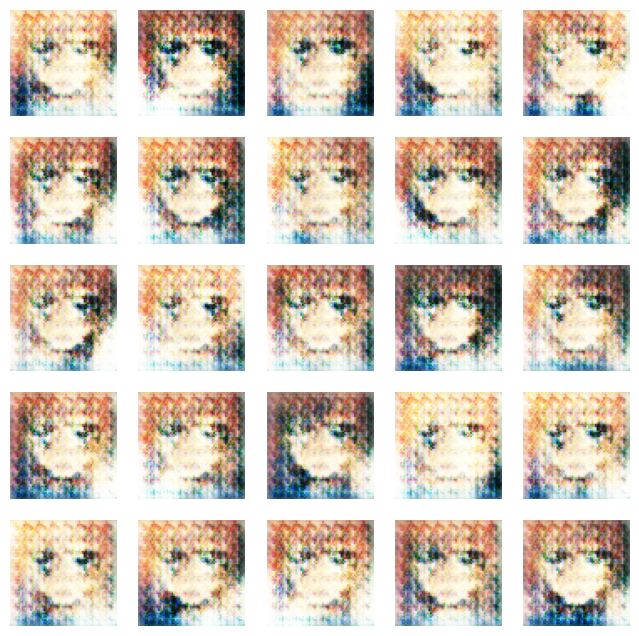

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 36ms/step - d_loss: 0.4291 - g_loss: 2.5389
Epoch 3/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.5859 - g_loss: 1.6146

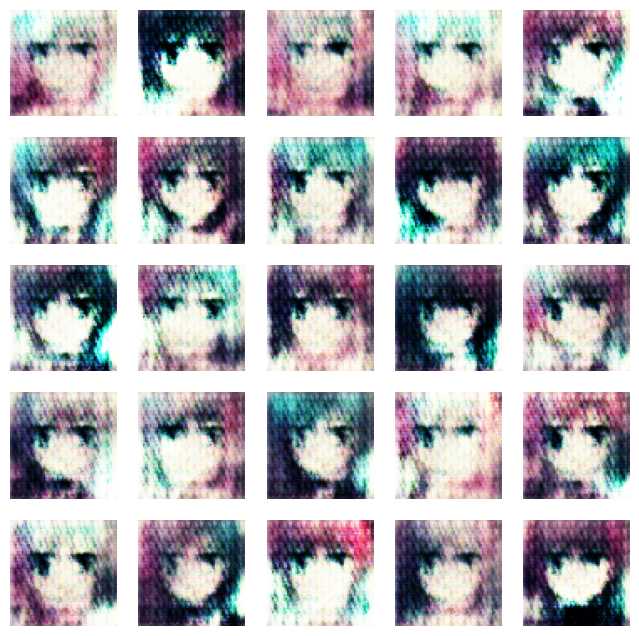

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.5859 - g_loss: 1.6146
Epoch 4/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.5972 - g_loss: 1.6551

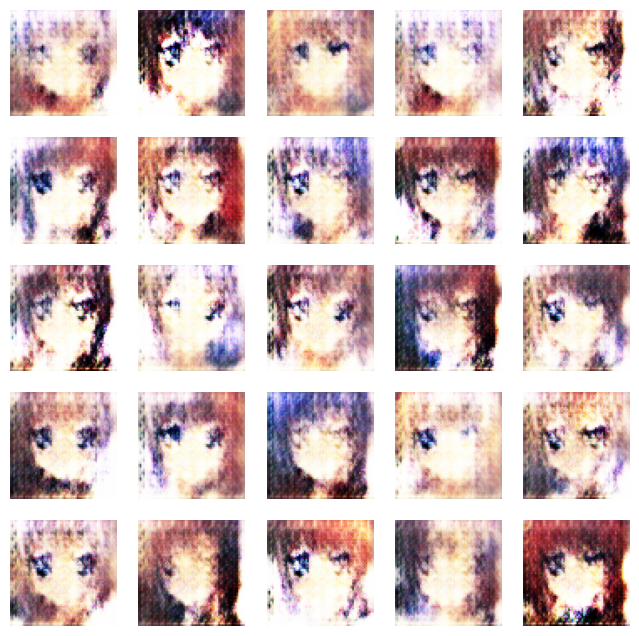

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.5972 - g_loss: 1.6551
Epoch 5/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6057 - g_loss: 1.6824

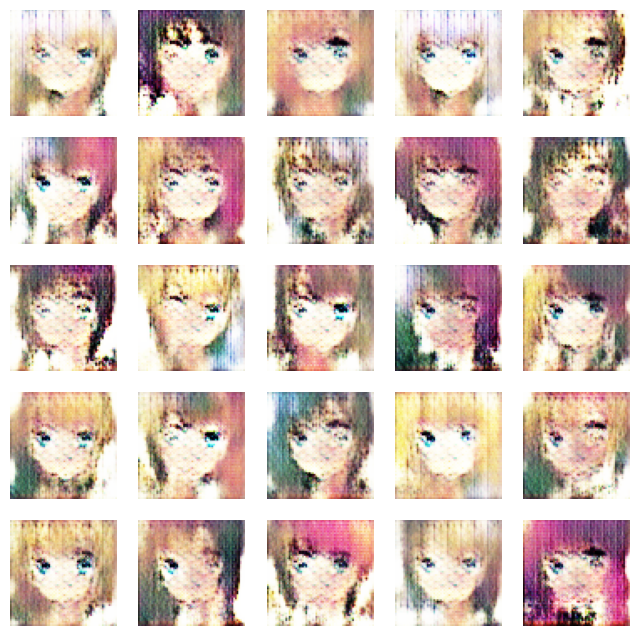

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 36ms/step - d_loss: 0.6056 - g_loss: 1.6823
Epoch 6/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6015 - g_loss: 1.6330

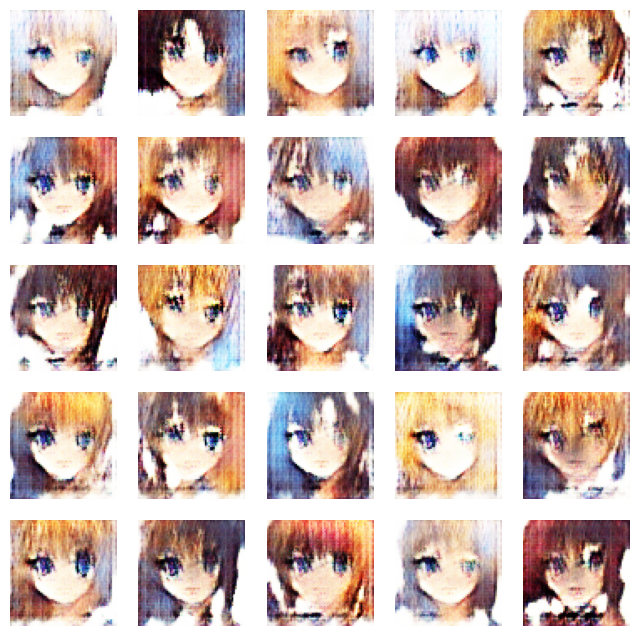

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6015 - g_loss: 1.6330
Epoch 7/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6173 - g_loss: 1.5292

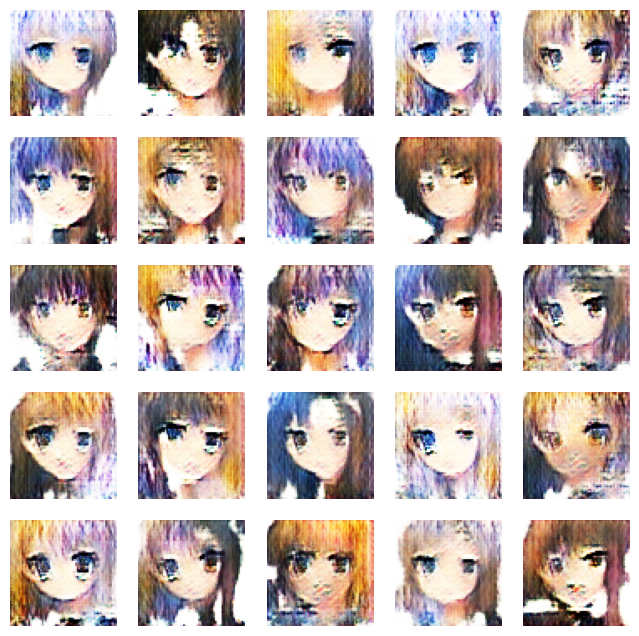

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6174 - g_loss: 1.5289
Epoch 8/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6655 - g_loss: 1.2360

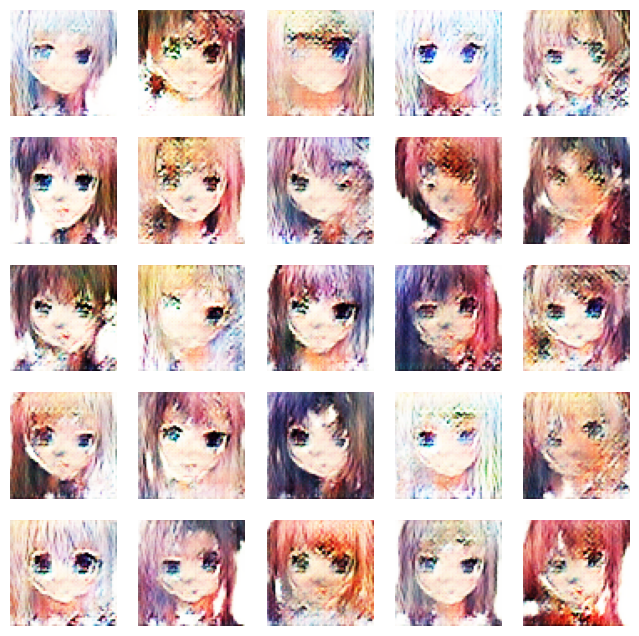

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 36ms/step - d_loss: 0.6655 - g_loss: 1.2358
Epoch 9/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6821 - g_loss: 1.0853

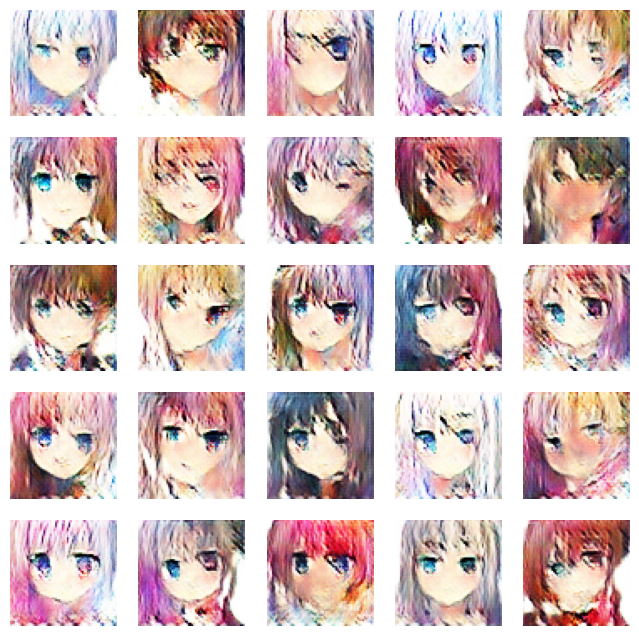

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6821 - g_loss: 1.0853
Epoch 10/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6935 - g_loss: 1.0413

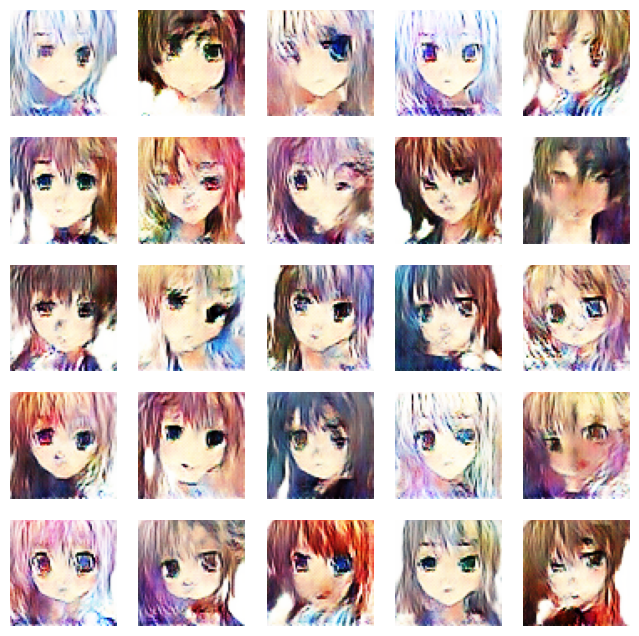

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 36ms/step - d_loss: 0.6935 - g_loss: 1.0412
Epoch 11/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6975 - g_loss: 0.9352

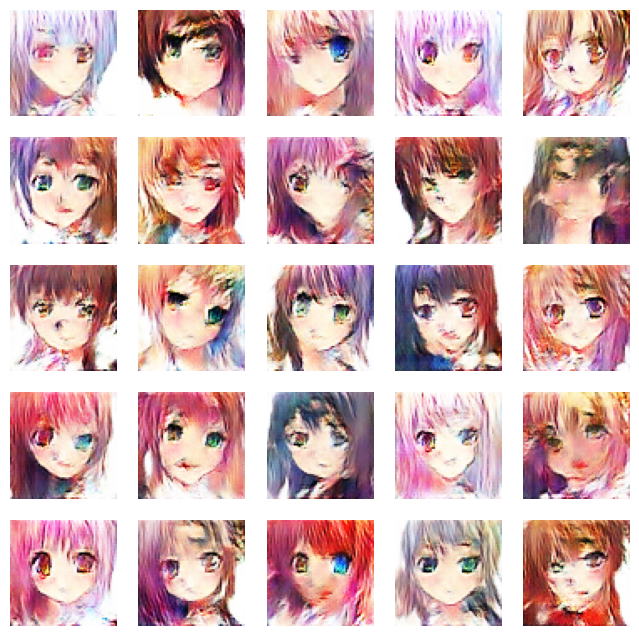

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6975 - g_loss: 0.9352
Epoch 12/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.7160 - g_loss: 0.8875

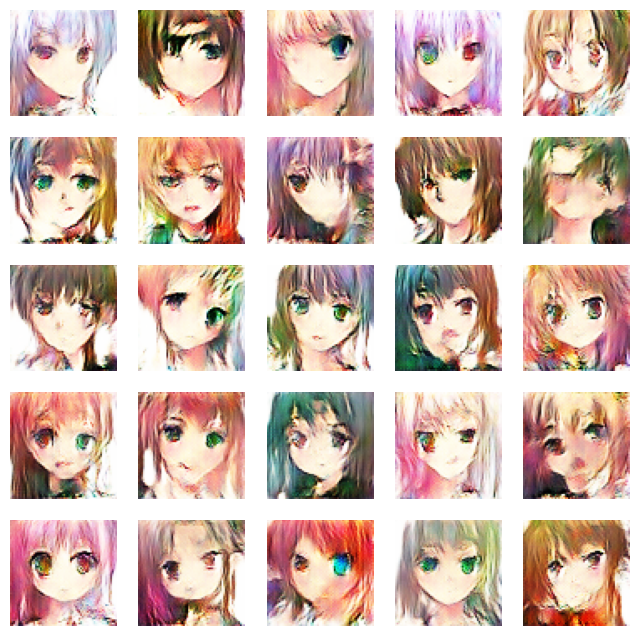

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.7160 - g_loss: 0.8875
Epoch 13/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.7199 - g_loss: 0.8340

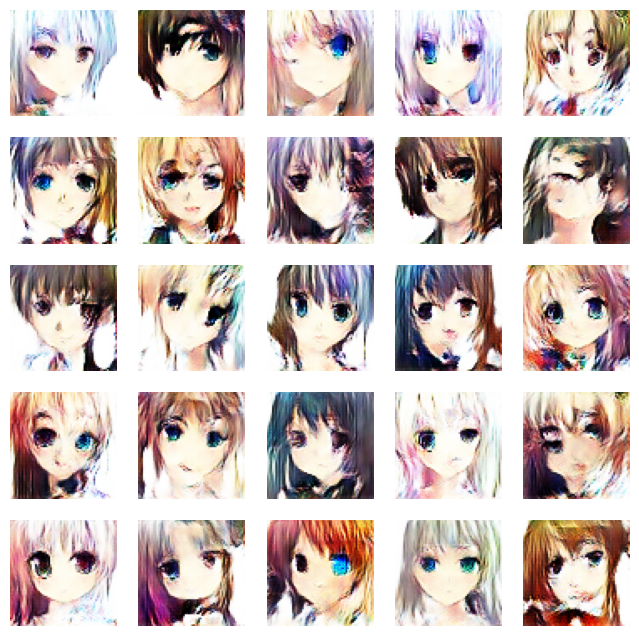

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.7199 - g_loss: 0.8340
Epoch 14/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.7197 - g_loss: 0.8226

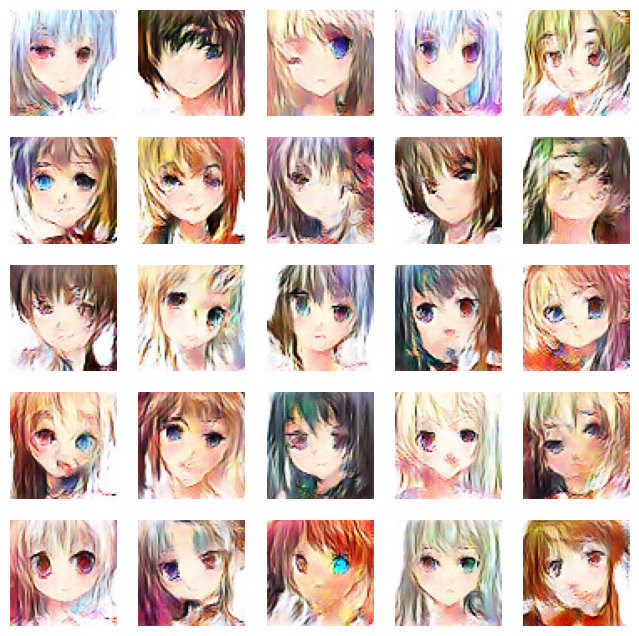

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 36ms/step - d_loss: 0.7197 - g_loss: 0.8226
Epoch 15/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.7164 - g_loss: 0.7939

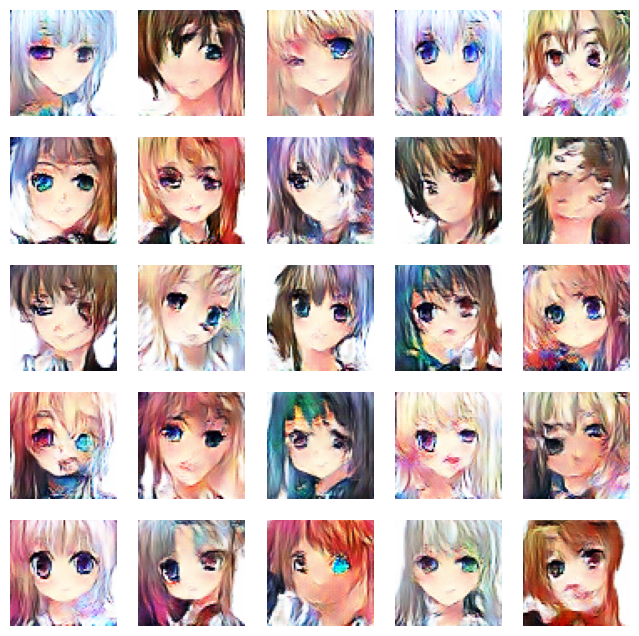

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.7164 - g_loss: 0.7939
Epoch 16/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.7145 - g_loss: 0.7583

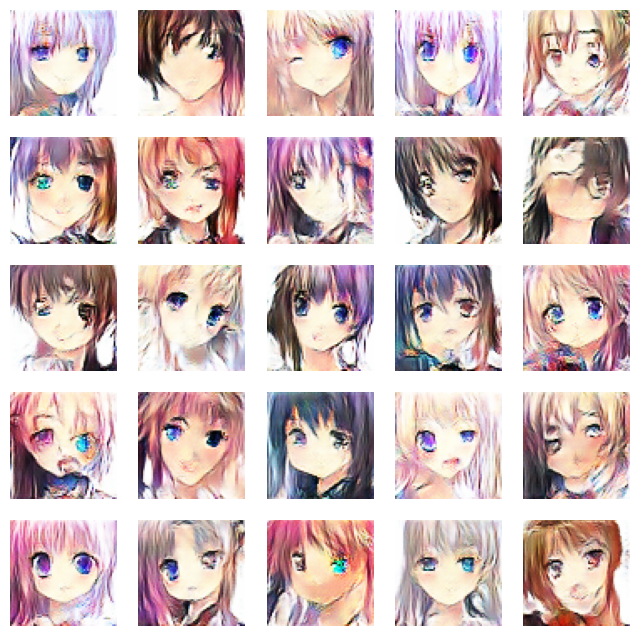

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.7145 - g_loss: 0.7583
Epoch 17/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.7129 - g_loss: 0.7640

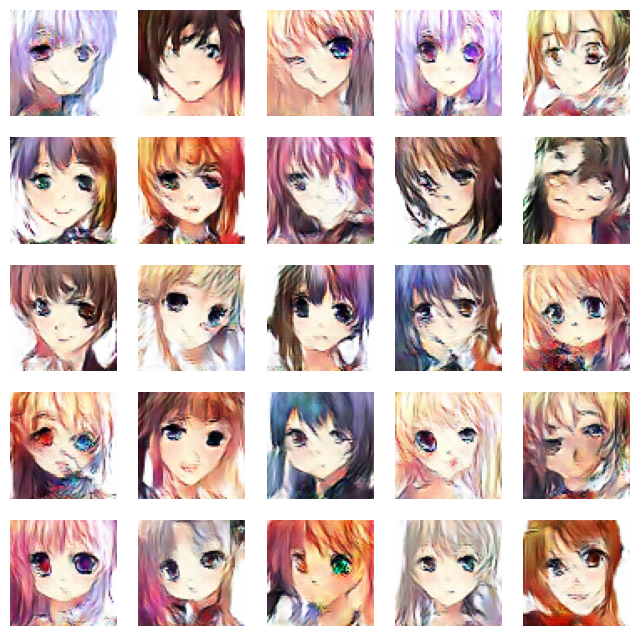

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.7129 - g_loss: 0.7640
Epoch 18/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.7088 - g_loss: 0.7594

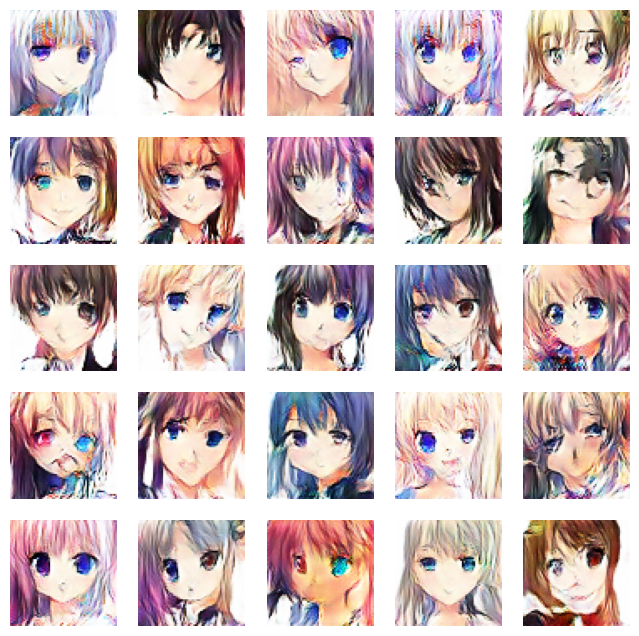

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.7088 - g_loss: 0.7594
Epoch 19/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.7057 - g_loss: 0.7493

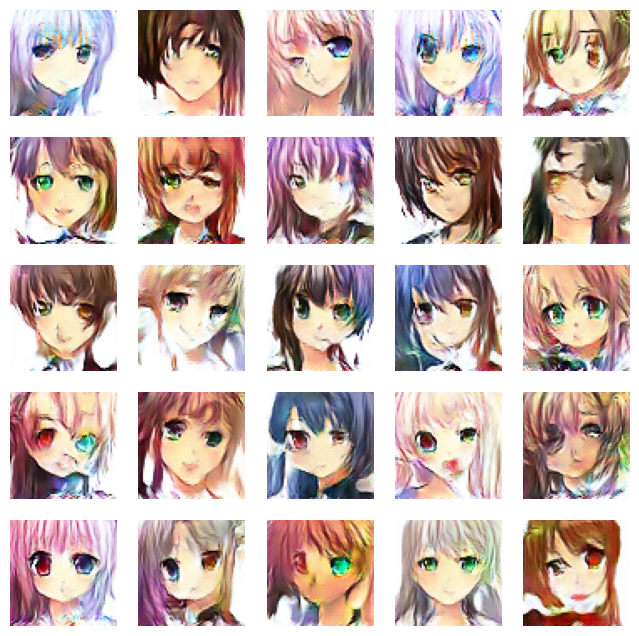

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.7057 - g_loss: 0.7494
Epoch 20/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.7054 - g_loss: 0.7524

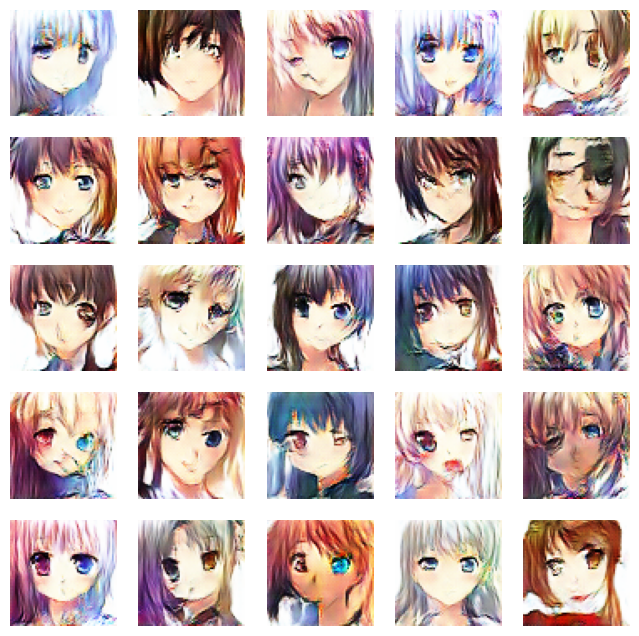

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.7054 - g_loss: 0.7524
Epoch 21/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.7034 - g_loss: 0.7466

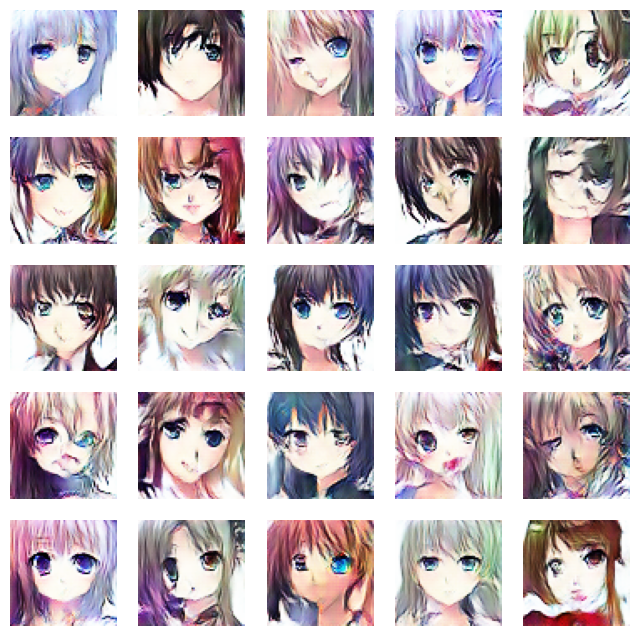

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.7034 - g_loss: 0.7466
Epoch 22/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.7009 - g_loss: 0.7548

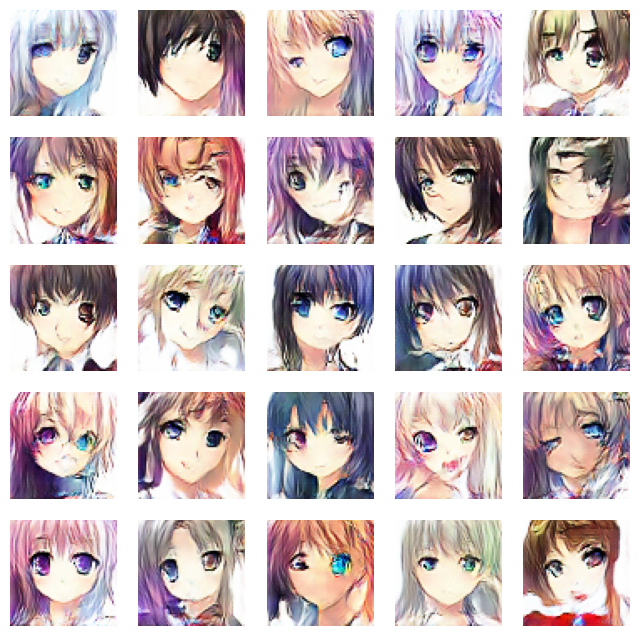

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.7009 - g_loss: 0.7548
Epoch 23/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6983 - g_loss: 0.7500

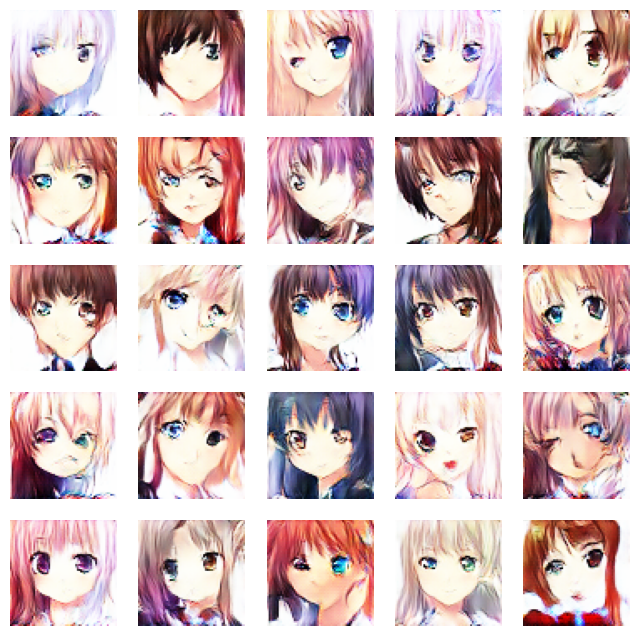

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6983 - g_loss: 0.7500
Epoch 24/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6974 - g_loss: 0.7543

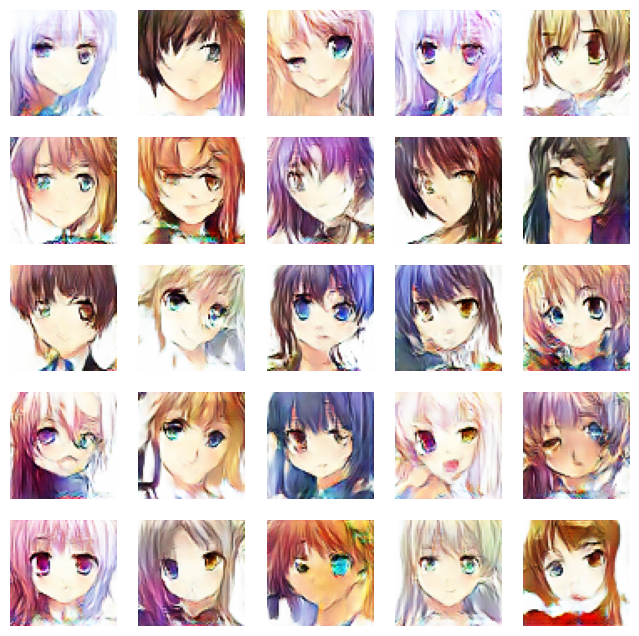

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6974 - g_loss: 0.7543
Epoch 25/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6969 - g_loss: 0.7532

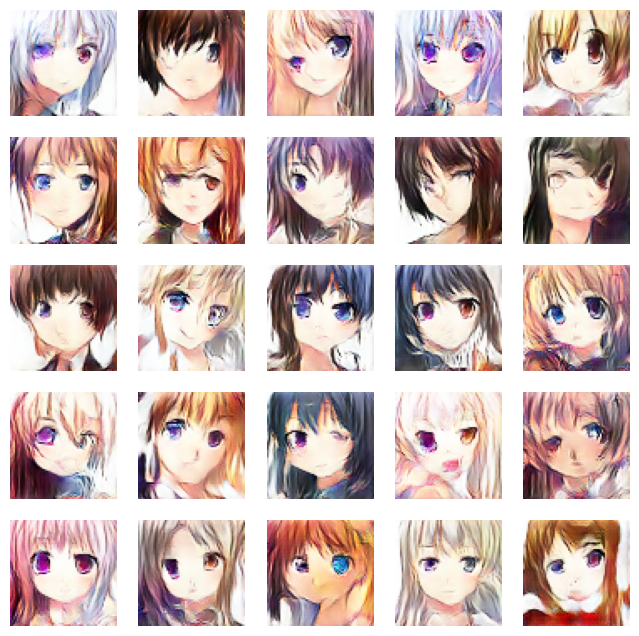

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6969 - g_loss: 0.7532
Epoch 26/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6950 - g_loss: 0.7579

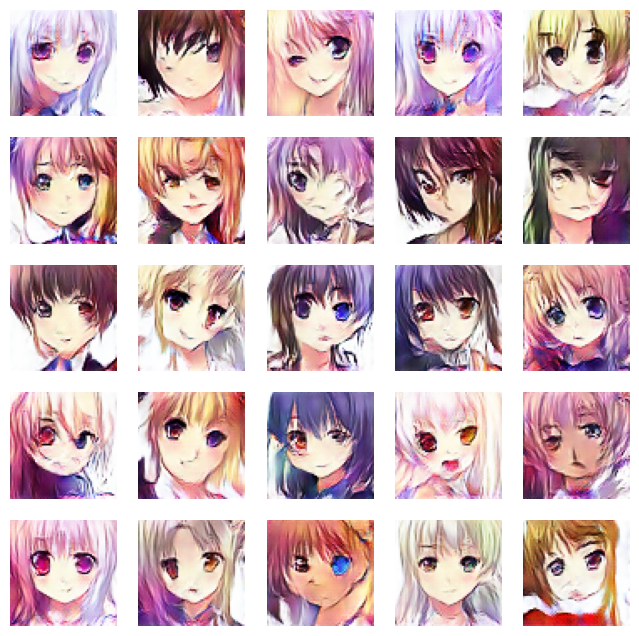

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6950 - g_loss: 0.7579
Epoch 27/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6917 - g_loss: 0.7599

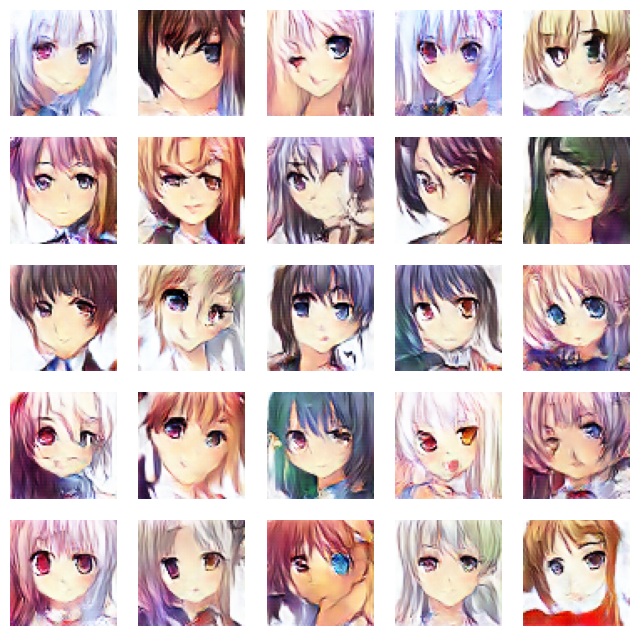

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6917 - g_loss: 0.7599
Epoch 28/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6898 - g_loss: 0.7617

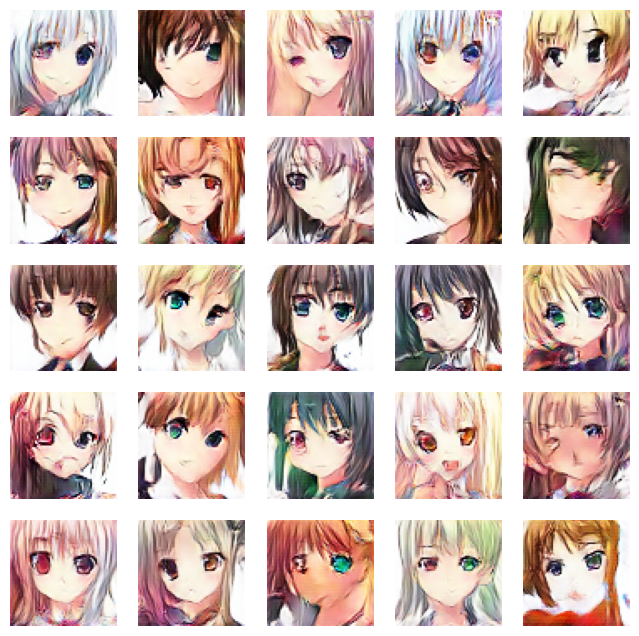

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6898 - g_loss: 0.7617
Epoch 29/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6859 - g_loss: 0.7714

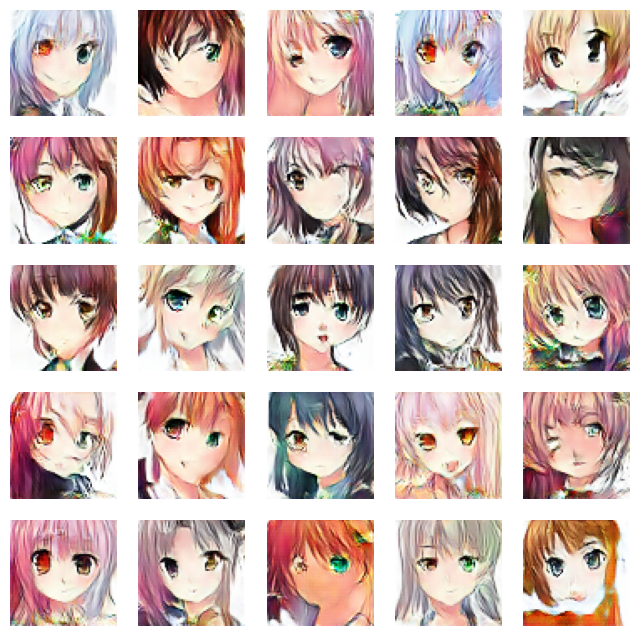

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6859 - g_loss: 0.7714
Epoch 30/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6855 - g_loss: 0.7768

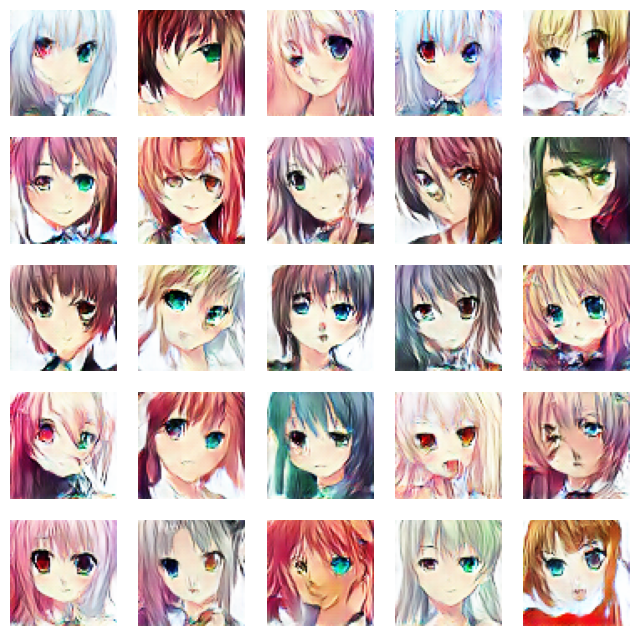

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6855 - g_loss: 0.7768
Epoch 31/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6819 - g_loss: 0.7838

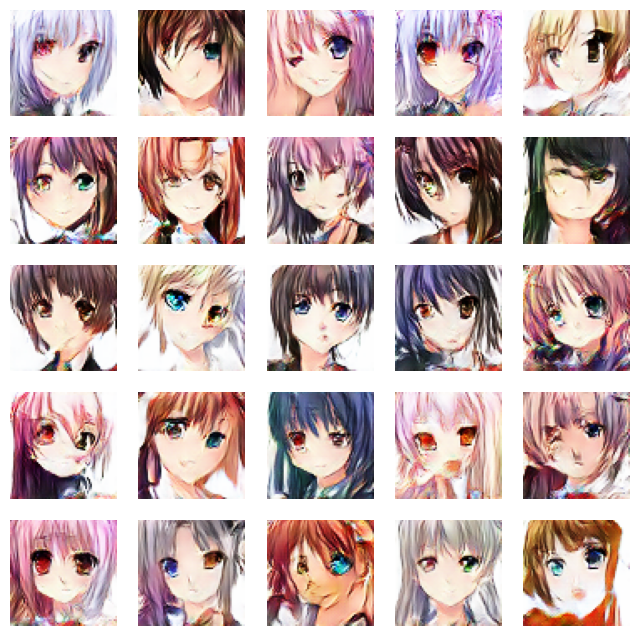

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6819 - g_loss: 0.7837
Epoch 32/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6803 - g_loss: 0.7868

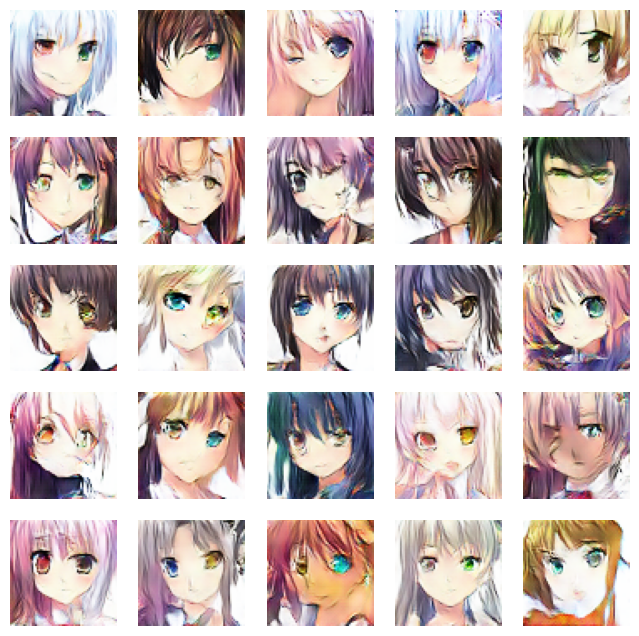

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6803 - g_loss: 0.7868
Epoch 33/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6781 - g_loss: 0.7914

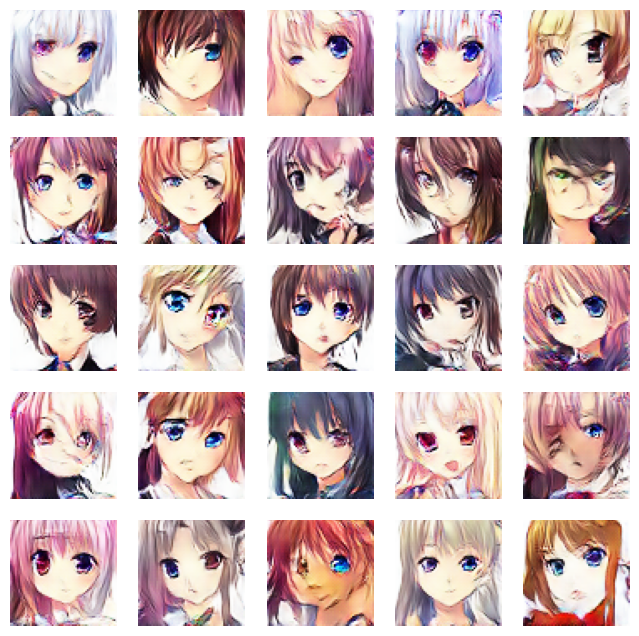

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6781 - g_loss: 0.7914
Epoch 34/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6761 - g_loss: 0.8016

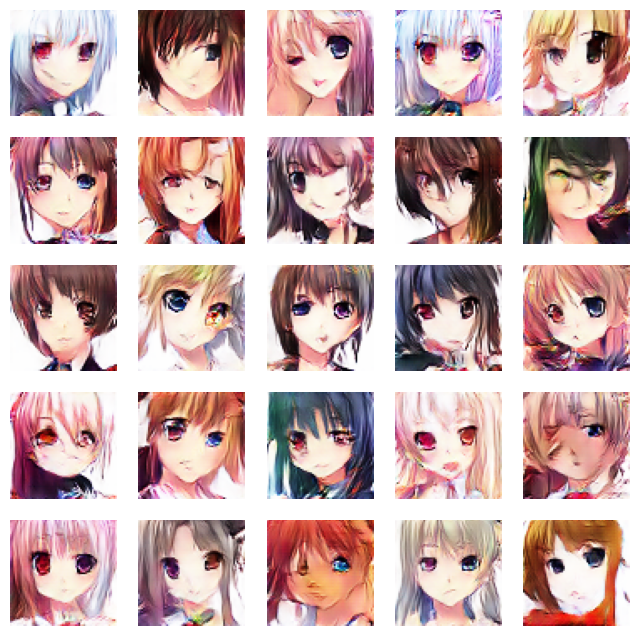

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6761 - g_loss: 0.8016
Epoch 35/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6732 - g_loss: 0.8057

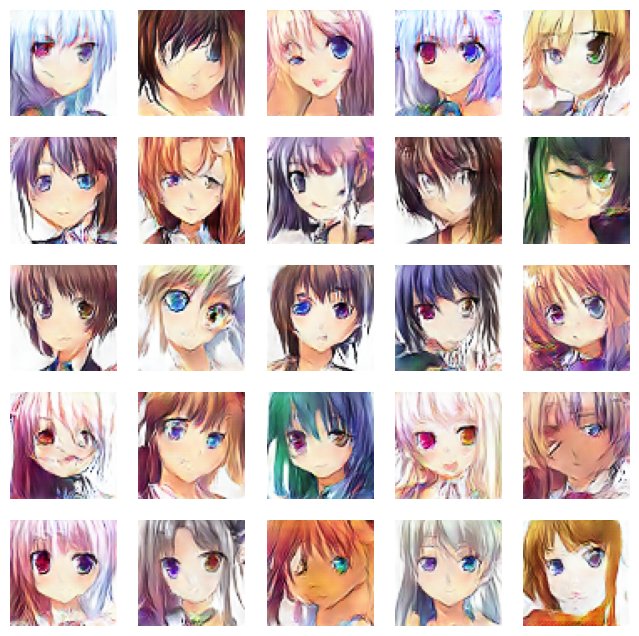

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6732 - g_loss: 0.8057
Epoch 36/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6713 - g_loss: 0.8138

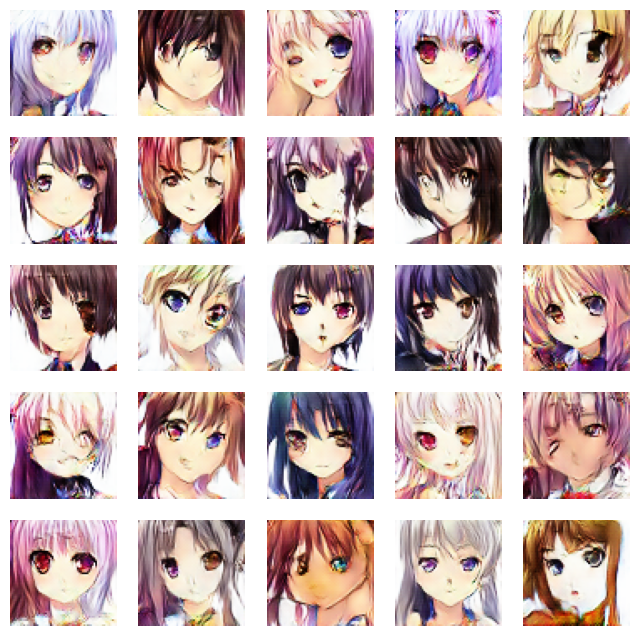

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6713 - g_loss: 0.8138
Epoch 37/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6657 - g_loss: 0.8168

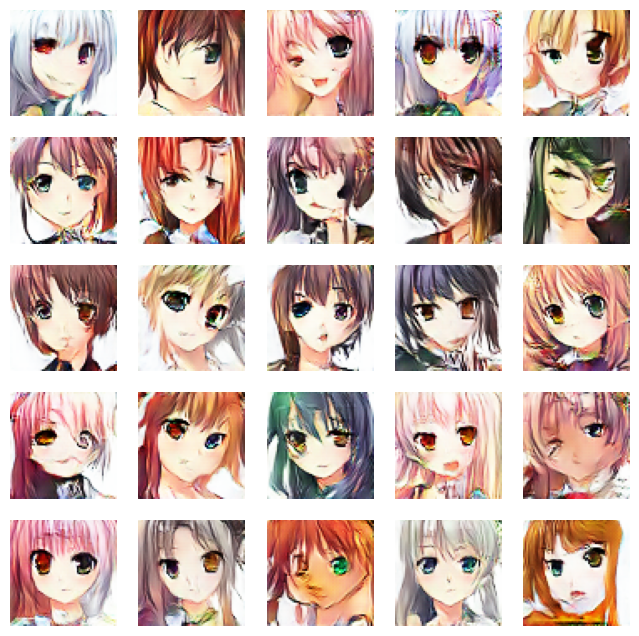

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6657 - g_loss: 0.8169
Epoch 38/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6622 - g_loss: 0.8390

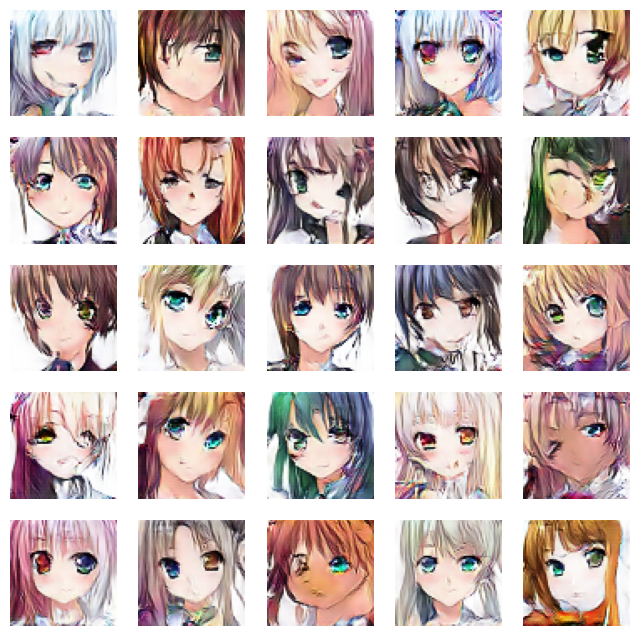

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6622 - g_loss: 0.8390
Epoch 39/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6565 - g_loss: 0.8419

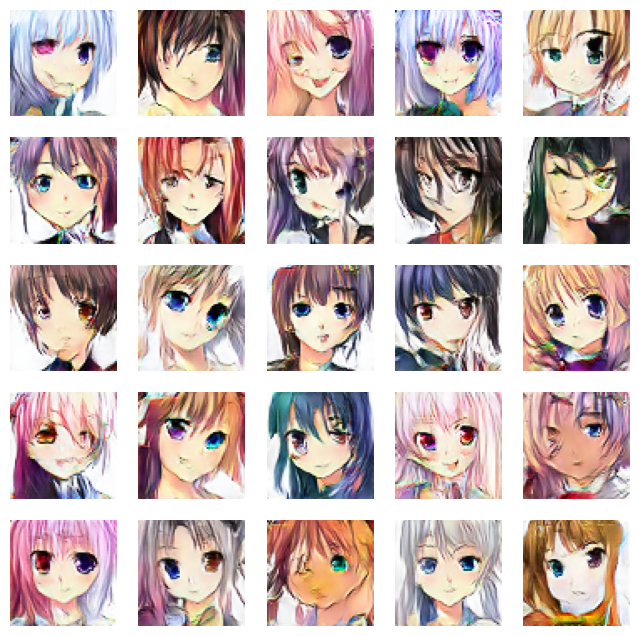

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6565 - g_loss: 0.8419
Epoch 40/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6538 - g_loss: 0.8599

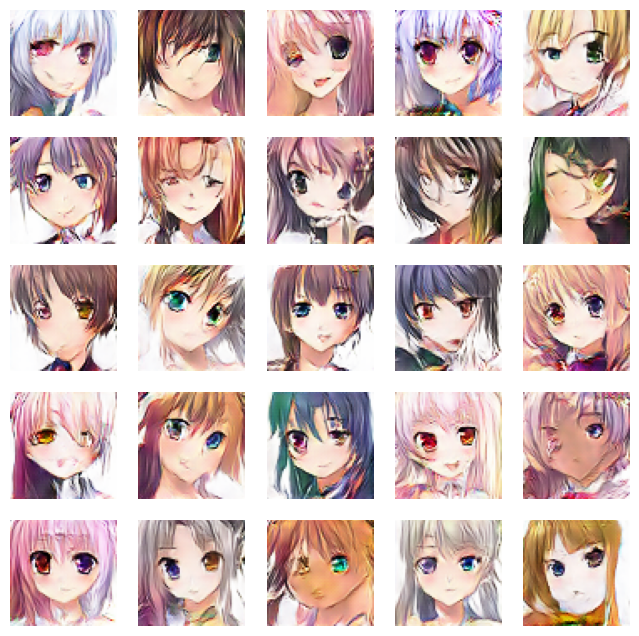

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6538 - g_loss: 0.8599
Epoch 41/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6482 - g_loss: 0.8863

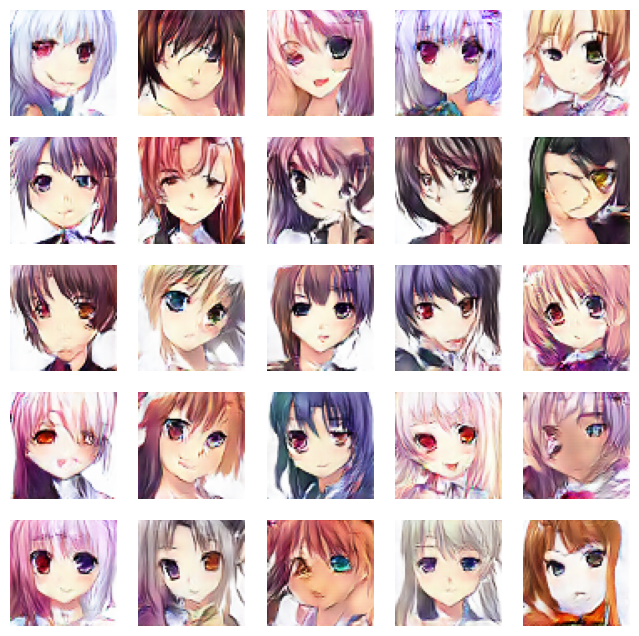

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6482 - g_loss: 0.8863
Epoch 42/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6460 - g_loss: 0.8913

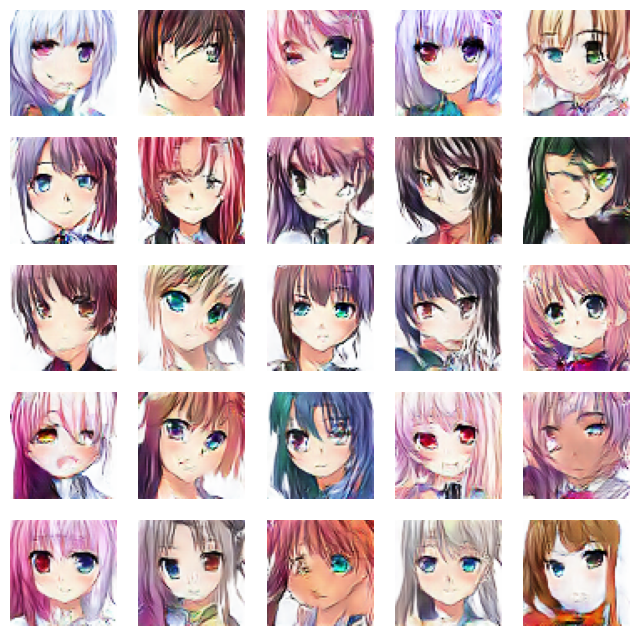

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6460 - g_loss: 0.8913
Epoch 43/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6399 - g_loss: 0.8969

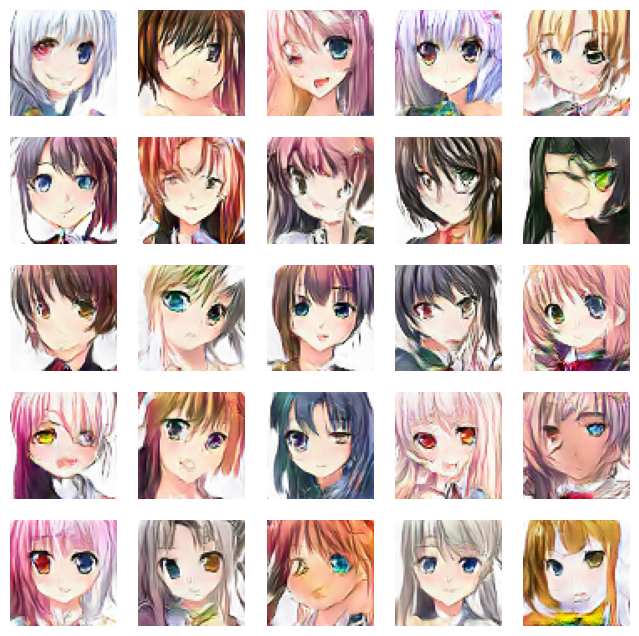

674/674 ━━━━━━━━━━━━━━━━━━━━ 24s 36ms/step - d_loss: 0.6399 - g_loss: 0.8969
Epoch 44/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.6360 - g_loss: 0.9178

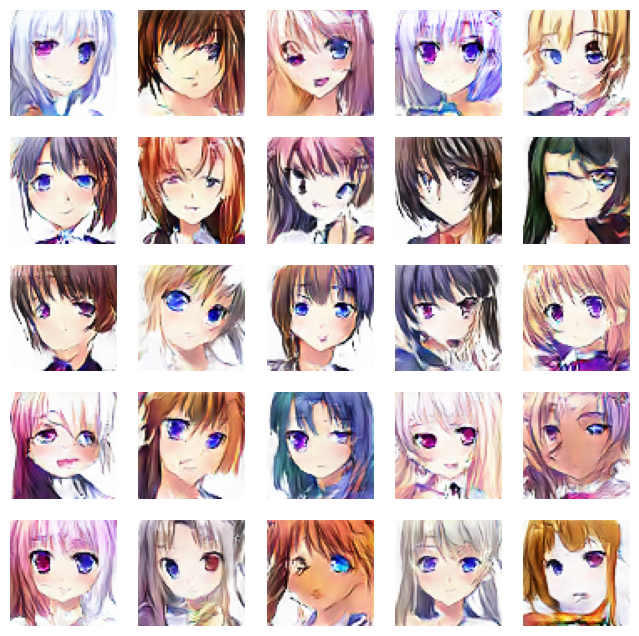

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6360 - g_loss: 0.9178
Epoch 45/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6339 - g_loss: 0.9250

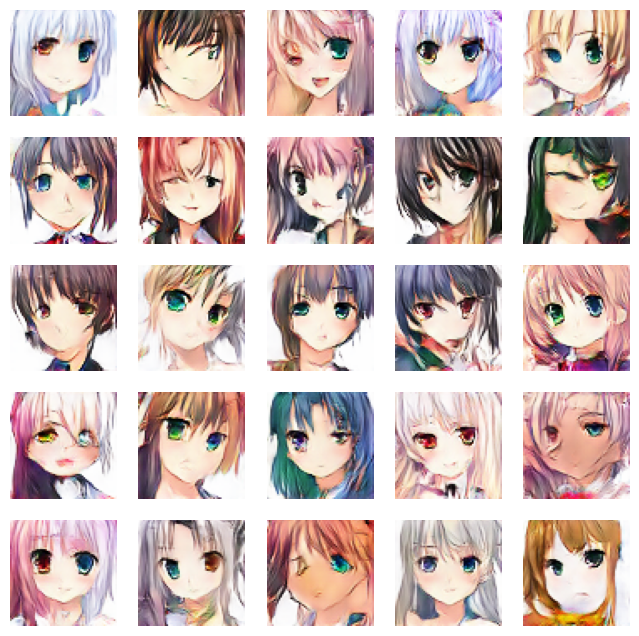

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6339 - g_loss: 0.9250
Epoch 46/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6281 - g_loss: 0.9436

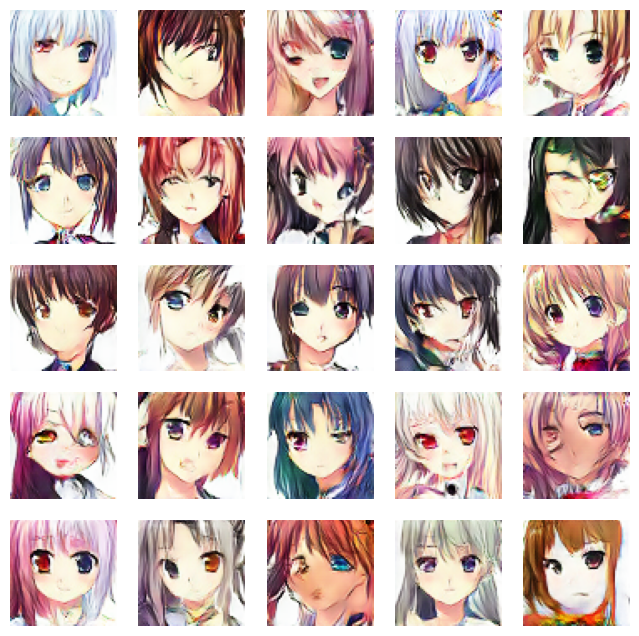

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6281 - g_loss: 0.9436
Epoch 47/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6197 - g_loss: 0.9606

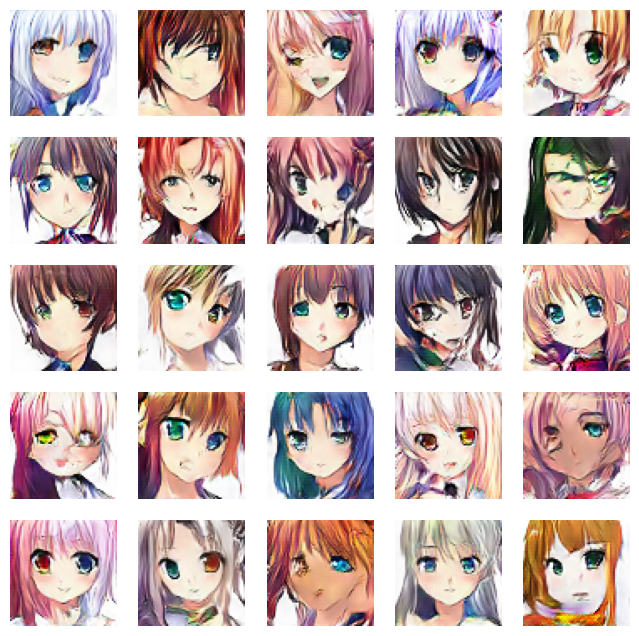

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6197 - g_loss: 0.9606
Epoch 48/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6195 - g_loss: 0.9753

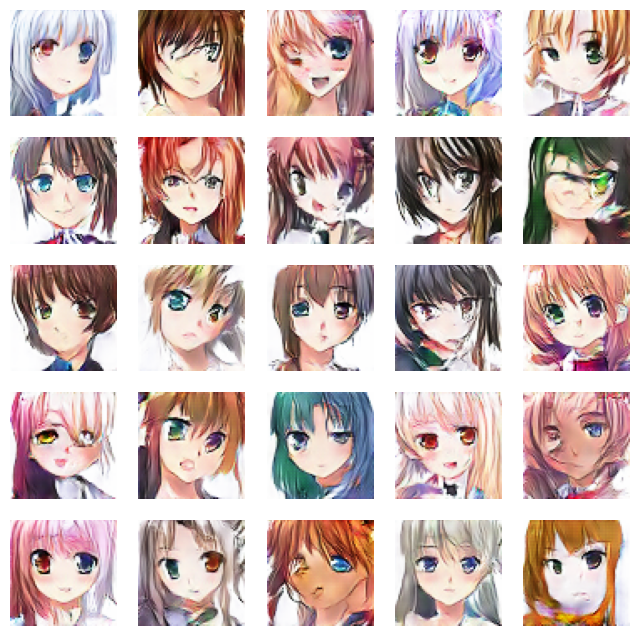

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6195 - g_loss: 0.9754
Epoch 49/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6121 - g_loss: 0.9988

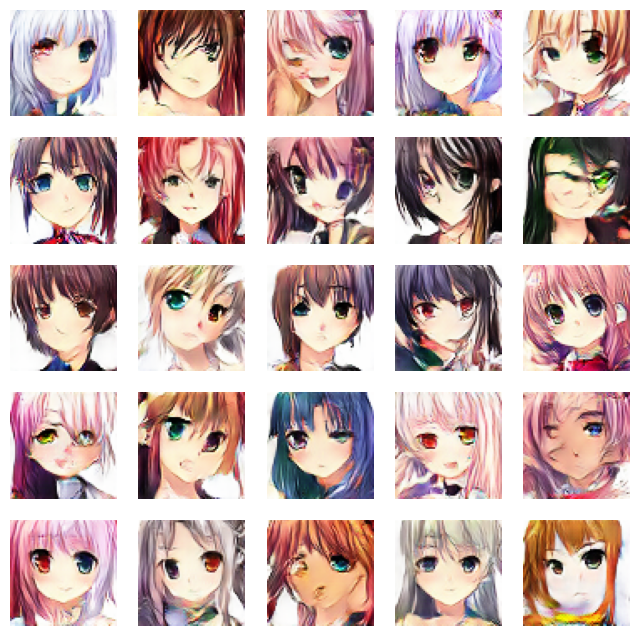

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6121 - g_loss: 0.9988
Epoch 50/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6125 - g_loss: 1.0013

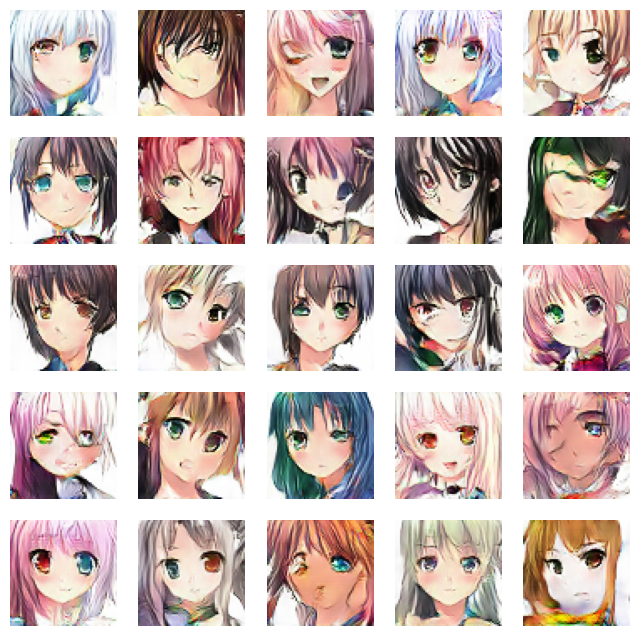

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6125 - g_loss: 1.0013


In [43]:
N_EPOCHS = 50
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

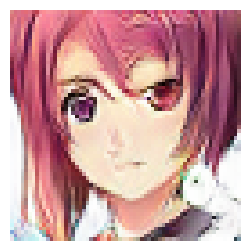

In [48]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()